In [2]:
# Goals:
# - Save examples of the output from each stage of your pipeline in the folder called output_images
#   - Include a description in your writeup for the project of what each image shows
# - The video called project_video.mp4 is the video your pipeline should work well on
# - challenge_video.mp4 and harder_challenge.mp4 are stretch goals

# Folder structure:
# CarND-Advanced-Lane-Lines
# |- camera_cal    - 20 chess boards for camera calibration
# |- examples
#   |- example.ipynb             - skeleton ipynb for this project. Uses glob API for reading images
#   |- binary_combo_example.jpg  - combination of binary filters (probably gradient magnitude and direction (Sobel) and HSV color filters)
#   |- color_fit_lines.jpg       - birds eye lane line image with lane line equations
#   |- example.py                - example of warping perspective
#   |- example_output.jpg        - shows left lane highlighted in red, entire lane in green, and right lane in blue, as well as diagnostic info of radius of curvature and position relative to lane center
#   |- undistort_output.png      - shows a chess board being undistorted "Original Image" and "Undistorted Image" (should capture same example for writeup)
#   |- warped_straight_lines.jpg - shows "Undistorted Image with source points drawn" and "Warped result with dest. points drawn"
# |- output_images - save output images here. Describe each image in the writeup.
# |- test_images
#   |- straight_lines*.jpg - two images of straight lanes, one with a yellow shoulder and one with white
#   |- test*.jpg           - curved lane images of segments with varying road surfaces
# |- challenge_video.mp4
# |- harder_challenge_video.mp4
# |- project_video.mp4

# common imports
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
from collections import OrderedDict, deque
%matplotlib inline

found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: False
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners for image camera_cal/calibration1.jpg: True
found corners

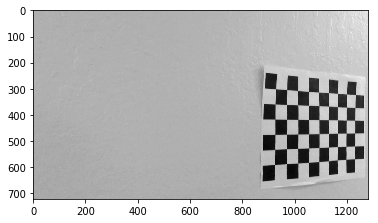

In [3]:
# Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
# images for camera calibration are stored in the folder called camera_cal
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
def get_calibration(images, debug=False):
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Step through the list and search for chessboard corners
    for image in images:
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(image, (9,6),None)

        # If found, add object points, image points
        if debug:
            print('found corners for image {}: {}'.format(fname, ret))
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            with_corners = cv2.drawChessboardCorners(img, (9,6), corners, ret)
            if debug:
                plt.imshow(with_corners)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, images[0].shape[::-1], None, None)
    if debug:
        plt.imshow(cv2.undistort(images[0], mtx, dist, None, mtx), cmap='gray')
    
    return mtx, dist
    
    # save warping for birds eye view section
    # Gets the camera transform matrix
    #M = cv2.getPerspectiveTransform(np.concatenate(imgpoints), np.concatenate(objpoints))
    # Warps to a top-down view
    #if debug:
        # warped = cv2.warpPerspective(last_gray, M, gray.shape[::-1])
        # plt.imshow(warped)
        

# Make a list of calibration images
chessboard_images = []
for fname in glob.glob('camera_cal/calibration*.jpg'):
    img = cv2.imread(fname)
    chessboard_images.append(cv2.cvtColor(img,cv2.COLOR_BGR2GRAY))
print(get_calibration(chessboard_images, debug=True))

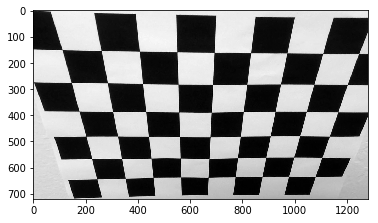

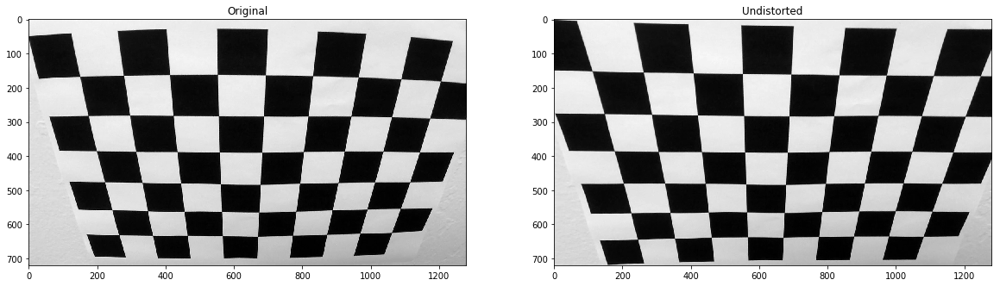

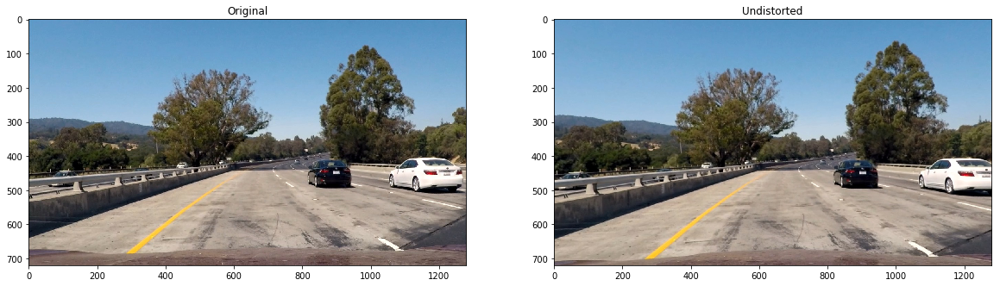

In [20]:
# Apply a distortion correction to raw images.
#
# The images in test_images are for testing your pipeline on single frames. If you want to extract more
# test images from the videos, you can simply use an image writing method like cv2.imwrite(), i.e., you
# can read the video in frame by frame as usual, and for frames you want to save for later you can write
# to an image file.

def undistort(img, mtx, dist, cmap=None, debug=False):
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    if debug:
        plt.imshow(undistorted, cmap=cmap)
    return undistorted
    
# Make a list of calibration images
chessboard_images = []
for fname in glob.glob('camera_cal/calibration*.jpg'):
    img = cv2.imread(fname)
    chessboard_images.append(cv2.cvtColor(img,cv2.COLOR_BGR2GRAY))
        
mtx, dist = get_calibration(chessboard_images)

original = chessboard_images[4]
undistorted = undistort(original, mtx, dist, cmap='gray', debug=True)
f, axes = plt.subplots(1, 2, figsize=(20, 10))
axes[0].set_title('Original')
axes[0].imshow(original, cmap='gray')
axes[1].set_title('Undistorted')
axes[1].imshow(undistorted, cmap='gray')
f.savefig('output_images/undistorted.png')


original_road = mpimg.imread('test_images/test1.jpg')
undistorted_road = undistort(original_road, mtx, dist, cmap='gray')
f_road, axes_road = plt.subplots(1, 2, figsize=(20, 10))
axes_road[0].set_title('Original')
axes_road[0].imshow(original_road)
axes_road[1].set_title('Undistorted')
axes_road[1].imshow(undistorted_road)
f_road.savefig('output_images/road_transformed.png')

interactive(children=(IntSlider(value=0, description='hmin', max=255), IntSlider(value=255, description='hmax', max=255), IntSlider(value=0, description='lmin', max=255), IntSlider(value=255, description='lmax', max=255), IntSlider(value=0, description='smin', max=255), IntSlider(value=255, description='smax', max=255), Output()), _dom_classes=('widget-interact',))

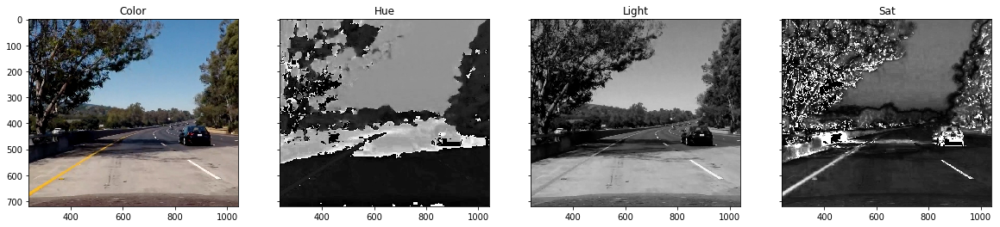

In [21]:
# Interactive filtering used to discover appropriate thresholds.
from IPython.display import display
from ipywidgets import widgets, interact, interactive, fixed, interact_manual
import os
import math
import matplotlib.image as mpimg

# interactive filter builder (features ordered by importance):
# exposes min/max range on each channel and displays them
# applys filters to image in real time
# choose initial color space transform (just choose HSV to simplify)

name = 'test5.jpg'
input_image = mpimg.imread('test_images/' + name)
input_hls = cv2.cvtColor(input_image, cv2.COLOR_RGB2HLS)

# Explode HLS channels
f, axes = plt.subplots(1, 4, sharey=True, figsize=(20,4))
axes[0].imshow(input_image)
axes[0].set_title('Color')
axes[1].imshow(input_hls[:,:,0], cmap='gray')
axes[1].set_title('Hue')
axes[2].imshow(input_hls[:,:,1], cmap='gray')
axes[2].set_title('Light')
axes[3].imshow(input_hls[:,:,2], cmap='gray')
axes[3].set_title('Sat')

def filter_channels(input_hsv, hmin, hmax, lmin, lmax, smin, smax):
    input_copy = np.copy(input_hsv)
    thresholds = ((input_hsv[:,:,0] >= hmin) & (input_hsv[:,:,0] <= hmax) &
                  (input_hsv[:,:,1] >= lmin) & (input_hsv[:,:,1] <= lmax) &
                  (input_hsv[:,:,2] >= smin) & (input_hsv[:,:,2] <= smax))
    input_copy[thresholds] = [255,255,255]
    # clunky...
    inverse = ((input_hsv[:,:,0] < hmin) | (input_hsv[:,:,0] > hmax) |
               (input_hsv[:,:,1] < lmin) | (input_hsv[:,:,1] > lmax) |
               (input_hsv[:,:,2] < smin) | (input_hsv[:,:,2] > smax))
    input_copy[inverse] = [0,0,0]
    return input_copy

def interactive_hls_filter(image):
    def f(hmin, hmax, lmin, lmax, smin, smax):
        plt.imshow(filter_channels(image, hmin, hmax, lmin, lmax, smin, smax))
    return f

interactive(interactive_hls_filter(input_hls),
            hmin=widgets.IntSlider(min=0,max=255,step=1,value=0),
            hmax=widgets.IntSlider(min=0,max=255,step=1,value=255),
            lmin=widgets.IntSlider(min=0,max=255,step=1,value=0),
            lmax=widgets.IntSlider(min=0,max=255,step=1,value=255),
            smin=widgets.IntSlider(min=0,max=255,step=1,value=0),
            smax=widgets.IntSlider(min=0,max=255,step=1,value=255))

# current setting:
# light: 33 - 255
# sat: 117 - 255

interactive(children=(IntSlider(value=0, description='sxmin', max=255), IntSlider(value=255, description='sxmax', max=255), Output()), _dom_classes=('widget-interact',))

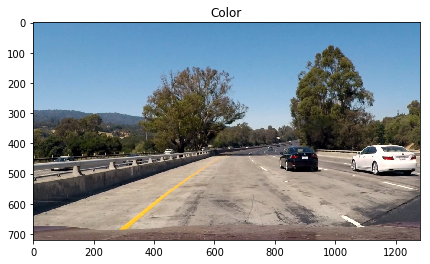

In [22]:
# Interactive filtering used to discover appropriate thresholds.
from IPython.display import display
from ipywidgets import widgets, interact, interactive, fixed, interact_manual
import os
import math
import matplotlib.image as mpimg

# interactive filter builder (features ordered by importance):
# exposes min/max range on each channel and displays them
# applys filters to image in real time
# choose initial color space transform (just choose HSV to simplify)

name = 'test1.jpg'
input_image = mpimg.imread('test_images/' + name)
gray = cv2.cvtColor(input_image, cv2.COLOR_RGB2GRAY)
input_hls = cv2.cvtColor(input_image, cv2.COLOR_RGB2HLS)
s = input_hls[:,:,2]
# Sobel x
sobelx = cv2.Sobel(s, cv2.CV_64F, 1, 0) # Take the derivative in x
abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

f, axes = plt.subplots(1, 1, sharey=True, figsize=(20,4))
axes.imshow(input_image)
axes.set_title('Color')

def filter_sobelx(scaled_sobel, sxmin, sxmax):
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sxmin) & (scaled_sobel <= sxmax)] = 1
    return sxbinary

def interactive_sobelx_filter(image):
    def f(sxmin, sxmax):
        plt.imshow(filter_sobelx(image, sxmin, sxmax), cmap='gray')
    return f

interactive(interactive_sobelx_filter(scaled_sobel),
            sxmin=widgets.IntSlider(min=0,max=255,step=1,value=0),
            sxmax=widgets.IntSlider(min=0,max=255,step=1,value=255))

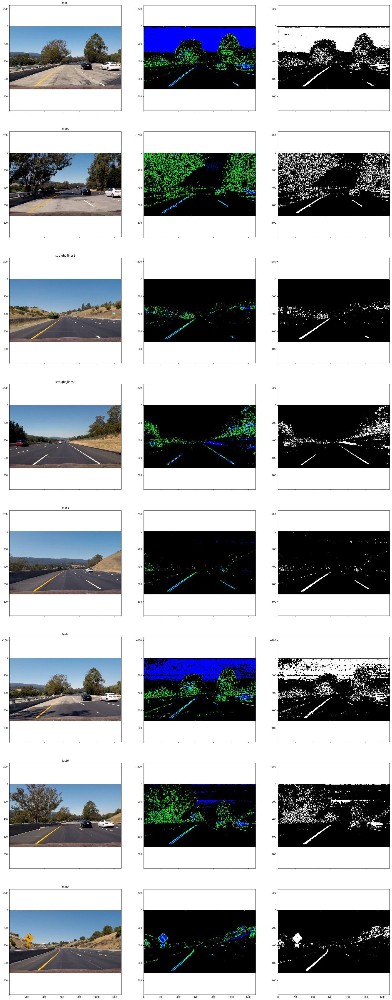

In [23]:
# Use color transforms, gradients, etc., to create a thresholded binary image.

def filter_gradient(img, debug=False):
    """filters gradient (on the saturation channel of HSV, since yellow shows up better there)"""
    input_hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = input_hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(s, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    thresh_min = 20
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return sxbinary

def filter_color(img, debug=False):
    """
    :param img: RGB image
    :return: filtered binary image
    """
    # Filter S channel (HLS) to 117-255
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # s_channel = hls[:,:,2]
    s_thresh_min = 117
    s_thresh_max = 255
    l_thresh_min = 33
    l_thresh_max = 255
    s_binary = np.zeros_like(hls[:,:,-1])
    s_binary[
        (hls[:,:,1] >= l_thresh_min) & (hls[:,:,1] <= l_thresh_max)
        & (hls[:,:,2] >= s_thresh_min) & (hls[:,:,2] <= s_thresh_max)] = 1
    return s_binary

def combine_binary(img1, img2, debug=False):
    combined = np.zeros_like(img1)
    combined[(img1 == 1) | (img2 == 1)] = 1
    return combined

# Try the filter on all road images
road_images = OrderedDict()
for fname in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(fname)
    road_images[fname[12:-4]]=img
f, axes = plt.subplots(len(road_images), 3, sharex=True, figsize=(30, len(road_images)*10))
for ((name, img), ax) in zip(road_images.items(), axes):
    ax[0].set_title(name)
    ax[0].imshow(img)
    sx_binary = filter_gradient(img)
    s_binary = filter_color(img)
    color_binary = np.dstack(( np.zeros_like(sx_binary), sx_binary, s_binary)) * 255
    ax[1].imshow(color_binary)
    combined = combine_binary(sx_binary, s_binary)
    ax[2].imshow(combined, cmap='gray')
f.savefig('output_images/binary_filter.png')


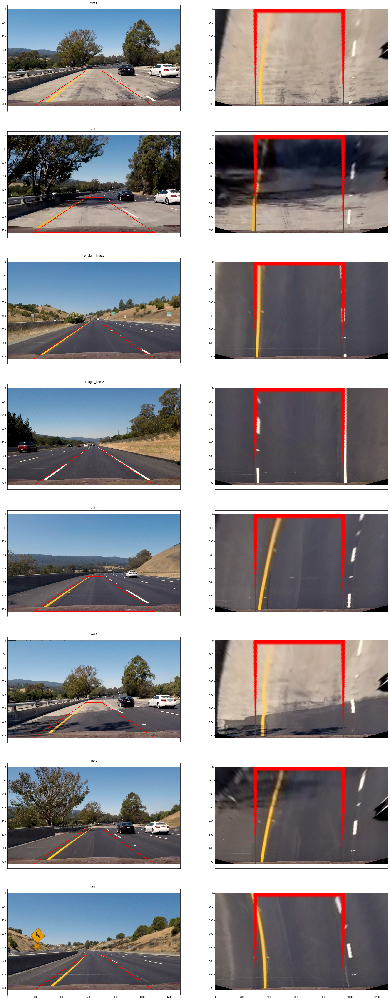

In [24]:
def warp(img, debug=False):
    src = np.float32([[192, 720], [576, 460], [703, 460], [1089, 720]])
    dest = np.float32([[300, 720], [300, 0], [950, 0], [950, 720]])
    M = cv2.getPerspectiveTransform(src, dest)
    warped = cv2.warpPerspective(img, M, combined.shape[::-1])
    return warped

def unwarp(img, debug=False):
    src = np.float32([[192, 720], [576, 460], [703, 460], [1089, 720]])
    dest = np.float32([[300, 720], [300, 0], [950, 0], [950, 720]])
    M = cv2.getPerspectiveTransform(dest, src)
    warped = cv2.warpPerspective(img, M, combined.shape[::-1])
    return warped

# Apply a perspective transform to rectify binary image ("birds-eye view").
def birds_eye_pipeline(img, debug=False):
    undist = undistort(img, mtx, dist)
    combined = combine_binary(filter_gradient(undist), filter_color(undist))
    
    if debug:
        img = np.copy(img)
        cv2.polylines(img,
                      [np.int32([[192, 720], [576, 460], [703, 460], [1089, 720]])],
                      True, color=[255, 0, 0], thickness=2)
    return img, warp(img)

# fig, ax = plt.subplots(figsize=(20, 20))
# ax.imshow(mpimg.imread('test_images/straight_lines1.jpg'))

# Try the filter on all road images
road_images = OrderedDict()
for fname in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(fname)
    road_images[fname[12:-4]]=img
f, axes = plt.subplots(len(road_images), 2, sharex=True, figsize=(30, len(road_images)*10))
for ((name, img), ax) in zip(road_images.items(), axes):
    ax[0].set_title(name)
    debug_img, warped = birds_eye_pipeline(img, debug=True)
    ax[0].imshow(debug_img)
    ax[1].imshow(warped)
f.savefig('output_images/warped.png')

memory: deque([(array([  1.51164215e-04,  -2.18475444e-01,   4.14554447e+02]), array([  4.60230250e-04,  -2.77151706e-02,   2.19121636e+00]), array([  1.22054251e-04,  -1.91112831e-01,   1.07442866e+03]), array([  3.71602885e-04,  -2.42440277e-02,   5.67912292e+00]))])
mem: [[[  1.51164215e-04  -2.18475444e-01   4.14554447e+02]
  [  4.60230250e-04  -2.77151706e-02   2.19121636e+00]
  [  1.22054251e-04  -1.91112831e-01   1.07442866e+03]
  [  3.71602885e-04  -2.42440277e-02   5.67912292e+00]]]
medians: [[  1.51164215e-04  -2.18475444e-01   4.14554447e+02]
 [  4.60230250e-04  -2.77151706e-02   2.19121636e+00]
 [  1.22054251e-04  -1.91112831e-01   1.07442866e+03]
 [  3.71602885e-04  -2.42440277e-02   5.67912292e+00]]

memory: deque([(array([  1.51164215e-04,  -2.18475444e-01,   4.14554447e+02]), array([  4.60230250e-04,  -2.77151706e-02,   2.19121636e+00]), array([  1.22054251e-04,  -1.91112831e-01,   1.07442866e+03]), array([  3.71602885e-04,  -2.42440277e-02,   5.67912292e+00])), (array(

memory: deque([(array([  4.26396594e-04,  -4.64947507e-01,   4.14419930e+02]), array([  1.29819489e-03,  -5.89819124e-02,   2.19050534e+00]), array([  7.64146530e-05,  -1.54160012e-01,   1.05549094e+03]), array([  2.32649869e-04,  -1.95562987e-02,   5.57902353e+00])), (array([ -4.18164743e-05,   9.52319660e-03,   3.25645458e+02]), array([ -1.27313243e-04,   1.20808551e-03,   1.72126885e+00]), array([  6.37212922e-06,   2.80745978e-02,   9.37584334e+02]), array([  1.94004026e-05,   3.56146326e-03,   4.95580291e+00])), (array([ -3.43535620e-06,  -8.76249691e-04,   3.20820611e+02]), array([ -1.04591873e-05,  -1.11158532e-04,   1.69576609e+00]), array([ -5.98893577e-07,   3.23171076e-03,   9.59806613e+02]), array([ -1.82337427e-06,   4.09965593e-04,   5.07326353e+00])), (array([  1.14160689e-04,  -2.96389043e-01,   4.83896119e+02]), array([  3.47570373e-04,  -3.75990672e-02,   2.55773663e+00]), array([  1.80759301e-04,  -2.69638701e-01,   1.08990901e+03]), array([  5.50334602e-04,  -3.4205

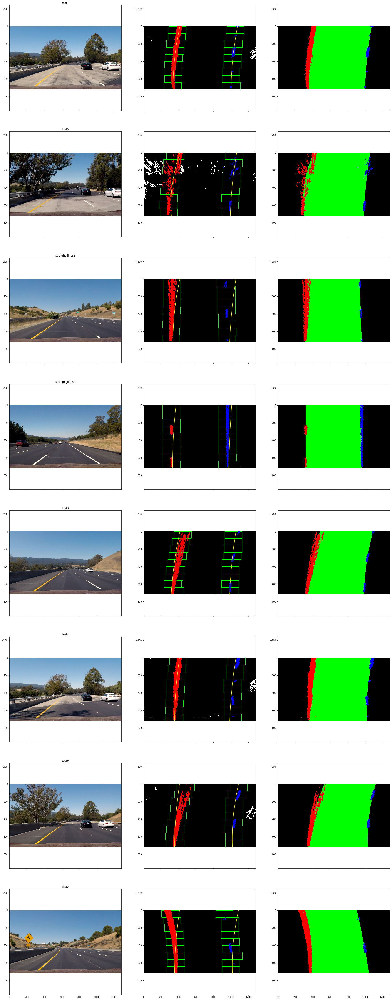

In [31]:
# Detect lane pixels and fit to find the lane boundary.
def find_lane_pixels(binary_warped, debug=False):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        # Find the four below boundaries of the window
        win_xleft_low = leftx_current-margin
        win_xleft_high = leftx_current+margin
        win_xright_low = rightx_current-margin
        win_xright_high = rightx_current+margin
        
        # Draw the windows on the visualization image
        if debug:
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),
            (win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),
            (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Find indices of nonzero elements in window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If we found > minpix pixels, recenter next window
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

def fit_polynomial(binary_warped, ax=None, memory=deque([]), mem_size=0, debug=False):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, lane_pixels = find_lane_pixels(binary_warped, debug=debug)

    # Fit a second order polynomial to each using `np.polyfit`
    ym_per_pxl = 30/720 # meters per pixel in y dimension
    xm_per_pxl = 3.7/700 # meters per pixel in x dimension
    
    dirty = False
    default_poly = [1,1,1]
    if leftx.size != 0:
        left_fit_pxl = np.polyfit(lefty, leftx, 2)
        left_fit_real = np.polyfit(lefty*ym_per_pxl, leftx*xm_per_pxl, 2)
    else:
        dirty = True
        left_fit_pxl = default_poly
        left_fit_real = default_poly
    if rightx.size != 0:
        right_fit_pxl = np.polyfit(righty, rightx, 2)
        right_fit_real = np.polyfit(righty*ym_per_pxl, rightx*xm_per_pxl, 2)
    else:
        dirty = True
        right_fit_pxl = default_poly
        right_fit_real = default_poly
        
    if not dirty and mem_size > 0:
        if len(memory) == mem_size:
            memory.popleft()
        memory.append((left_fit_pxl, left_fit_real, right_fit_pxl, right_fit_real))
        mem = np.array(memory)
        meds = np.median(mem, axis=0)
        if debug:
            print('memory: {}\nmem: {}\nmedians: {}\n'.format(memory, mem, meds))
        left_fit_pxl, left_fit_real, right_fit_pxl, right_fit_real = meds[0], meds[1], meds[2], meds[3]

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit_pxl[0]*ploty**2 + left_fit_pxl[1]*ploty + left_fit_pxl[2]
        right_fitx = right_fit_pxl[0]*ploty**2 + right_fit_pxl[1]*ploty + right_fit_pxl[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    if not debug:
        # When not in debug, get rid of non-lane pixels
        lane_pixels = np.zeros_like(lane_pixels)
        #print("ploty shape: {}, left_fitx shape: {}, right_fitx shape: {}".format(ploty.shape, left_fitx.shape, right_fitx.shape))
        for i in range(ploty.shape[-1]):
            y, left, right = int(ploty[i]), int(left_fitx[i]), int(right_fitx[i])
            #print("y: {}, left: {}, right: {}".format(y, left, right))
            lane_pixels[y, left:right] = [0, 255, 0]
    lane_pixels[lefty, leftx] = [255, 0, 0]
    lane_pixels[righty, rightx] = [0, 0, 255]

    if ax:
        # Plots the left and right polynomials on the lane lines
        ax.plot(left_fitx, ploty, color='yellow')
        ax.plot(right_fitx, ploty, color='yellow')

    return left_fit_real, right_fit_real, lane_pixels

def fit_poly_pipeline(img, ax, debug=False):
    undist = undistort(img, mtx, dist)
    warped = warp(combine_binary(filter_gradient(undist), filter_color(undist)))
    _, _, fit = fit_polynomial(warped, ax=ax, debug=debug)
    _, _, with_lanes = fit_polynomial(warped, debug=False)
    return fit, with_lanes

def fit_poly_with_mem_pipeline(img, ax, mem=deque([]), debug=False):
    undist = undistort(img, mtx, dist)
    warped = warp(combine_binary(filter_gradient(undist), filter_color(undist)))
    _, _, fit = fit_polynomial(warped, ax=ax, memory=mem, mem_size=5, debug=debug)
    _, _, with_lanes = fit_polynomial(warped, debug=False)
    return fit, with_lanes

road_images = OrderedDict()
for fname in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(fname)
    road_images[fname[12:-4]]=img
f, axes = plt.subplots(len(road_images), 3, sharex=True, figsize=(30, len(road_images)*10))
mem = deque([])
for ((name, img), ax) in zip(road_images.items(), axes):
    ax[0].set_title(name)
    lane_pixels, with_lanes = fit_poly_with_mem_pipeline(img, ax=ax[1], mem=mem, debug=True)
    ax[0].imshow(img)
    ax[1].imshow(lane_pixels)
    ax[2].imshow(with_lanes)
f.savefig('output_images/color_fit_lines.png')

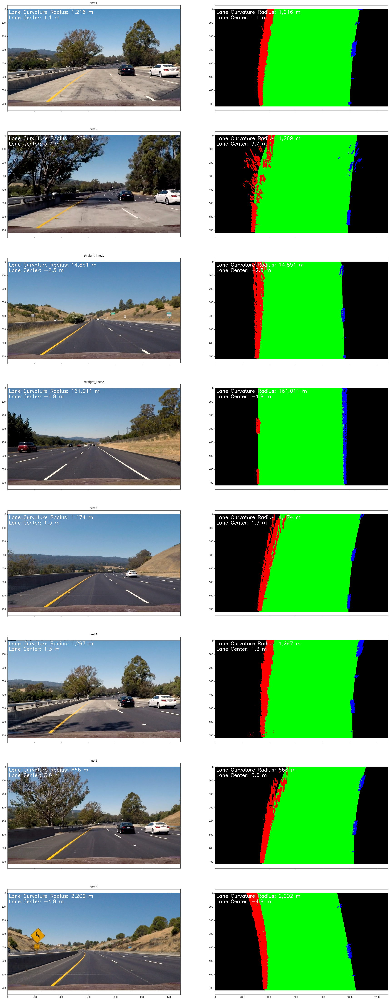

In [28]:
# Determine the curvature of the lane and vehicle position with respect to center.

def measure_curvature_meters(left_fit, right_fit, y=(1200*30/720)):
    '''
    Calculates the curvature of polynomial functions in pixels. Assumes meter-scale coordinates.
    '''
    a, b = left_fit[0], left_fit[1]
    left_curverad = ((1 + (2*a*y + b)**2)**(3/2))/abs(2*a)
    a, b = right_fit[0], right_fit[1]
    right_curverad = ((1 + (2*a*y + b)**2)**(3/2))/abs(2*a)
    return left_curverad, right_curverad

def measure_offset(left_fit_pxl, right_fit_pxl, y=1200):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    left = left_fit_pxl[0]*y**2 + left_fit_pxl[1]*y + left_fit_pxl[2]
    right = right_fit_pxl[0]*y**2 + right_fit_pxl[1]*y + right_fit_pxl[2]
    avg = (left + right)/2
    
    # offset vs image center
    img_center = 720 / 2
    offset_pix = avg - img_center
    return offset_pix * xm_per_pix

def display_curvature(img, left_fit, right_fit):
    displayed = np.copy(img)
    left_curverad, right_curverad = measure_curvature_meters(left_fit, right_fit)
    avg = (left_curverad + right_curverad)/2
    text = 'Lane Curvature Radius: {:,.0f} m'.format(avg)
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(displayed, text, (10, 35), font, 1.2, (255,255,255), thickness=2)
    
    offset = measure_offset(left_fit, right_fit)
    text = 'Lane Center: {:,.1f} m'.format(offset)
    cv2.putText(displayed, text, (10, 75), font, 1.2, (255,255,255), thickness=2)
    return displayed

def display_curvature_pipeline(img, ax, debug=False):
    undist = undistort(img, mtx, dist)
    warped = warp(combine_binary(filter_gradient(undist), filter_color(undist)))
    left_fit, right_fit, fit = fit_polynomial(warped, debug=False)
    return display_curvature(img, left_fit, right_fit), display_curvature(fit, left_fit, right_fit)

road_images = OrderedDict()
for fname in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(fname)
    road_images[fname[12:-4]]=img
f, axes = plt.subplots(len(road_images), 2, sharex=True, figsize=(30, len(road_images)*10))
for ((name, img), ax) in zip(road_images.items(), axes):
    ax[0].set_title(name)
    img_with_curve, fit_with_curve = display_curvature_pipeline(img, ax=ax[1], debug=True)
    ax[0].imshow(img_with_curve)
    ax[1].imshow(fit_with_curve)


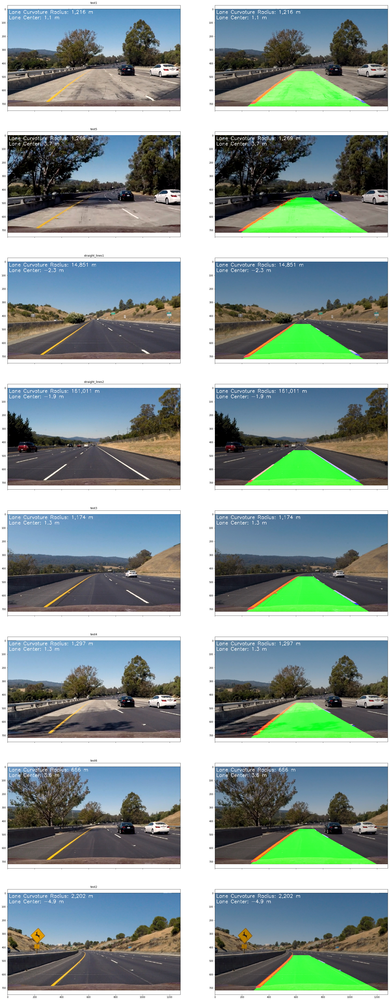

In [32]:
# Warp the detected lane boundaries back onto the original image.

def display_lane(img, lane_img, α=0.8, β=1., γ=0.):
    lane_img = unwarp(np.copy(lane_img))
    return cv2.addWeighted(np.copy(img), α, lane_img, β, γ)

def display_lane_pipeline(img, ax, debug=False):
    undist = undistort(img, mtx, dist)
    warped = warp(combine_binary(filter_gradient(undist), filter_color(undist)))
    left_fit, right_fit, fit = fit_polynomial(warped, debug=False)
    displayed_lane = display_lane(img, fit)
    return display_curvature(img, left_fit, right_fit), display_curvature(displayed_lane, left_fit, right_fit)

road_images = OrderedDict()
for fname in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(fname)
    road_images[fname[12:-4]]=img
f, axes = plt.subplots(len(road_images), 2, sharex=True, figsize=(30, len(road_images)*10))
for ((name, img), ax) in zip(road_images.items(), axes):
    ax[0].set_title(name)
    img_with_curve, fit_with_curve = display_lane_pipeline(img, ax=ax[1], debug=True)
    ax[0].imshow(img_with_curve)
    ax[1].imshow(fit_with_curve)
f.savefig('output_images/output.png')

In [14]:
mem = deque([])
def final_pipeline(img):
    undist = undistort(img, mtx, dist)
    warped = warp(combine_binary(filter_gradient(undist), filter_color(undist)))
    left_fit, right_fit, fit = fit_polynomial(warped, memory=mem, mem_size=10, debug=False)
    return display_curvature(display_lane(img, fit), left_fit, right_fit)

from moviepy.editor import VideoFileClip

names = ['project_video',
         'challenge_video',
         'harder_challenge_video',
        ]
for name in names:
    project_video_output = 'test_videos_output/{}_output.mp4'.format(name)
    clip = VideoFileClip('{}.mp4'.format(name))
    project_video_clip = clip.fl_image(final_pipeline)
    %time project_video_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video_output.mp4
[MoviePy] Writing video test_videos_output/project_video_output.mp4


100%|█████████▉| 1260/1261 [04:51<00:00,  4.20it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video_output.mp4 

CPU times: user 2min 49s, sys: 3.33 s, total: 2min 52s
Wall time: 4min 54s
[MoviePy] >>>> Building video test_videos_output/challenge_video_output.mp4
[MoviePy] Writing video test_videos_output/challenge_video_output.mp4


100%|██████████| 485/485 [01:44<00:00,  4.96it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/challenge_video_output.mp4 

CPU times: user 58.7 s, sys: 1.16 s, total: 59.9 s
Wall time: 1min 46s
[MoviePy] >>>> Building video test_videos_output/harder_challenge_video_output.mp4
[MoviePy] Writing video test_videos_output/harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [05:22<00:00,  3.82it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/harder_challenge_video_output.mp4 

CPU times: user 2min 52s, sys: 3.32 s, total: 2min 56s
Wall time: 5min 26s


In [33]:
from IPython.display import HTML

HTML("""
<video width="960" height="540" controls>
  <source src="test_videos_output/{0}_output.mp4">
</video>
<video width="960" height="540" controls>
  <source src="test_videos_output/{1}_output.mp4">
</video>
<video width="960" height="540" controls>
  <source src="test_videos_output/{2}_output.mp4">
</video>
""".format('project_video', 'challenge_video', 'harder_challenge_video'))